<a href="https://colab.research.google.com/github/Elnabrees/first-game/blob/main/Copy_of_Lab_10.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Lab 10: Image Segmentation

In [ ]:
import numpy as np
from skimage.transform import (hough_line, hough_line_peaks, hough_circle, hough_circle_peaks)
from skimage.draw import circle_perimeter
from skimage.feature import canny
from skimage.data import astronaut
from skimage.io import imread, imsave
from skimage.color import rgb2gray, gray2rgb, label2rgb
from skimage import img_as_float
from skimage.morphology import skeletonize
from skimage import data, img_as_float
import matplotlib.pyplot as pylab
import matplotlib.pyplot as plt
from matplotlib import cm
from skimage.filters import sobel, threshold_otsu
from skimage.feature import canny
from skimage.segmentation import felzenszwalb, slic, watershed
from skimage.segmentation import mark_boundaries, find_boundaries


def plot_image(image, title='', fontsize=5):
    pylab.title(title, size=20), pylab.imshow(image)
    pylab.axis('off') # comment this line if you want axis ticks

--------
## Hough transform – detecting lines and circles
------

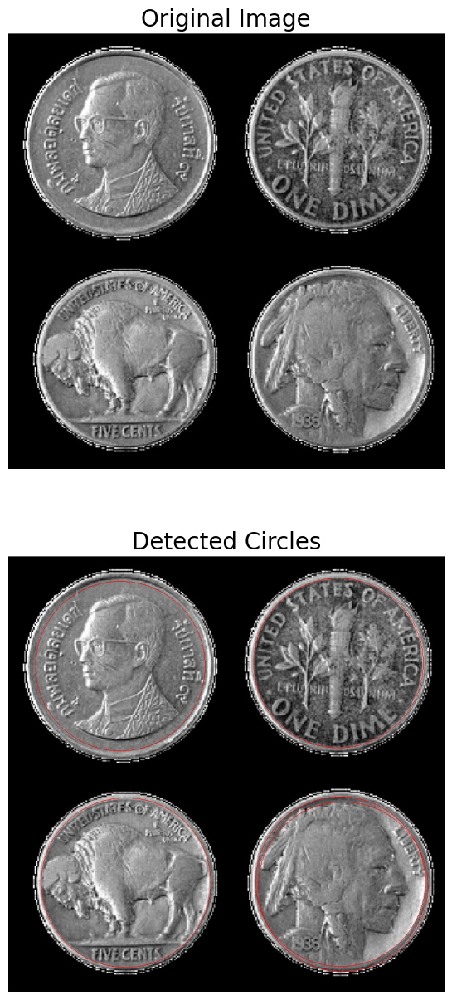

In [ ]:
image = rgb2gray(imread('images/coins.jpg'))

hough_radii = np.arange(35, 185, 1)
hough_res = hough_circle(image, hough_radii)

# Select the most prominent 5 circles
accums, cx, cy, radii = hough_circle_peaks(hough_res, hough_radii, total_num_peaks=5)

image2 = gray2rgb(image)
for center_y, center_x, radius in zip(cy, cx, radii):
    circy, circx = circle_perimeter(center_y, center_x, radius)
    image2[circy, circx] = (1, 0, 0)


pylab.figure(figsize=(20,15))
pylab.gray()
pylab.subplot(211), plot_image(image, 'Original Image')
pylab.subplot(212), plot_image(image2, 'Detected Circles')
pylab.show()

------
## Thresholding and Otsu's segmentation
--------

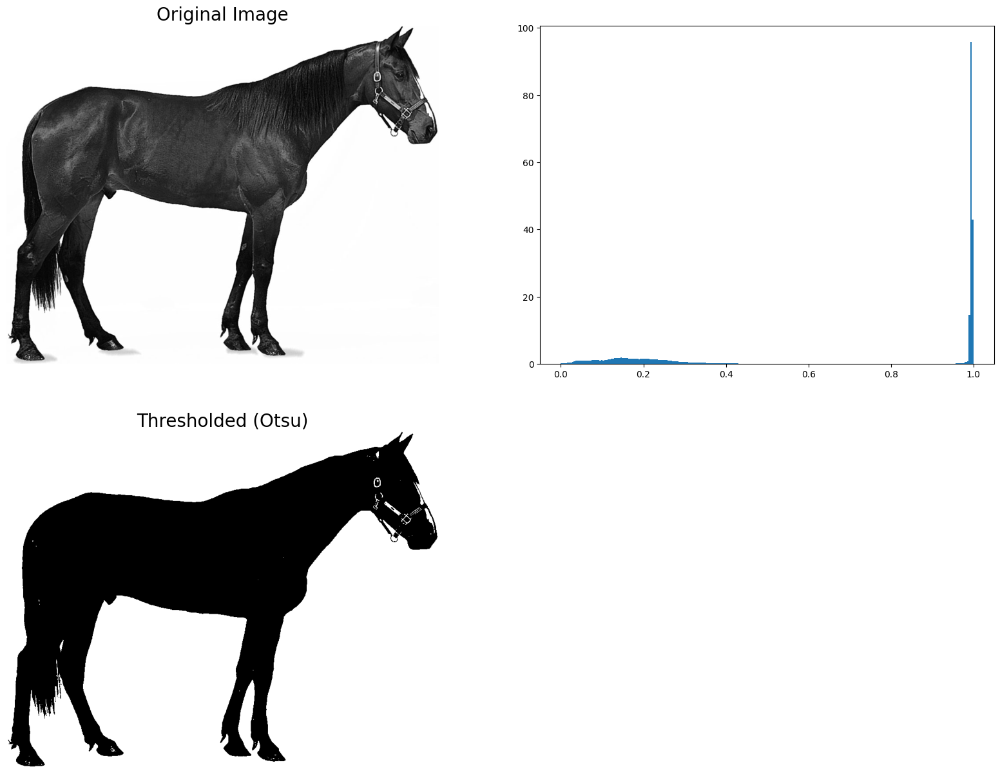

In [ ]:
image =  rgb2gray(imread('images/horse.jpg')) #data.camera()
thresh = threshold_otsu(image)
binary = image > thresh

pylab.figure(figsize=(20, 15))
pylab.gray()
pylab.subplot(221), plot_image(image, 'Original Image')
plt.subplot(222), plt.hist(image.ravel(), bins=256, density=True)
pylab.subplot(223), plot_image(binary, 'Thresholded (Otsu)')
pylab.show()


--------
# Edges-based/region-based segmentation
-----

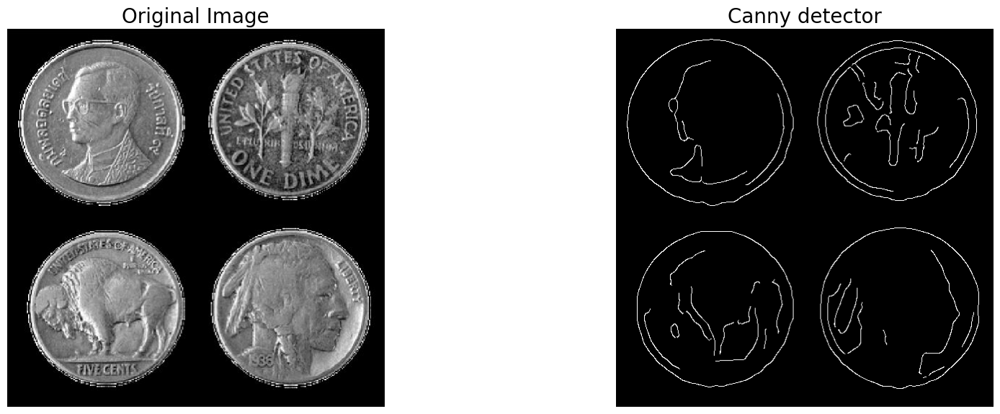

In [ ]:
coins = image =  rgb2gray(imread('images/coins6.JPG'))  # data.coins()

edges = canny(coins, sigma=4)  # change sigma=2,3 will produce different effect, 4 will produce good result

pylab.figure(figsize=(20, 15))
pylab.gray()
pylab.subplot(221), plot_image(coins, 'Original Image')
pylab.subplot(222), plot_image(edges, 'Canny detector')

pylab.show()

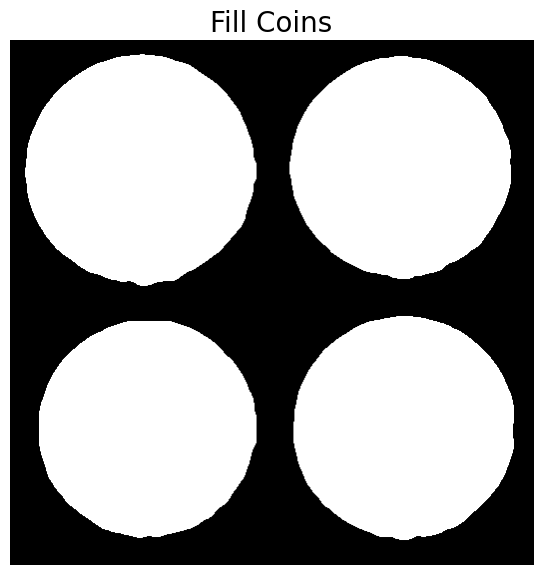

In [ ]:
from scipy import ndimage as ndi

fill_coins = ndi.binary_fill_holes(edges)

pylab.figure(figsize=(20, 15))
pylab.gray()
pylab.subplot(221), plot_image(fill_coins, 'Fill Coins')
pylab.show()


---
### Region Based: Morphology Segmentation
---

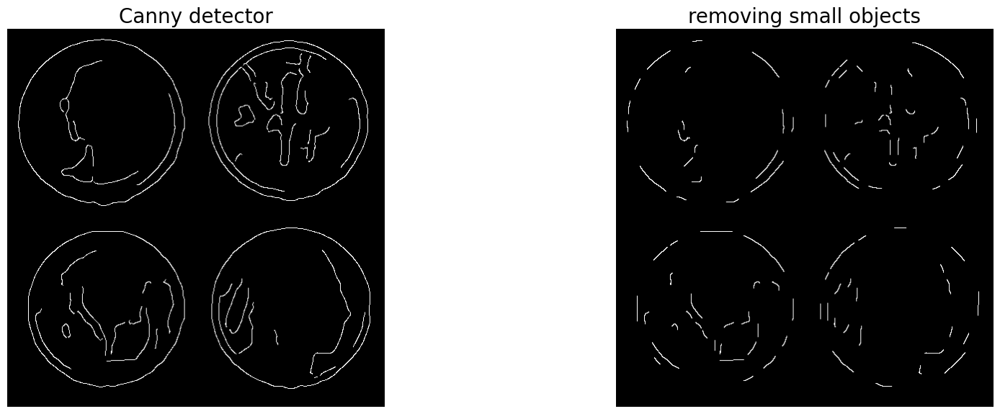

In [ ]:
from skimage import morphology

coins_cleaned = morphology.remove_small_objects(edges, 15) # change 15 to 5,8,12,18,21,24,27... remove objects

pylab.figure(figsize=(20, 15))
pylab.gray()
pylab.subplot(221), plot_image(edges, 'Canny detector')
pylab.subplot(222), plot_image(coins_cleaned, 'removing small objects')
pylab.show()



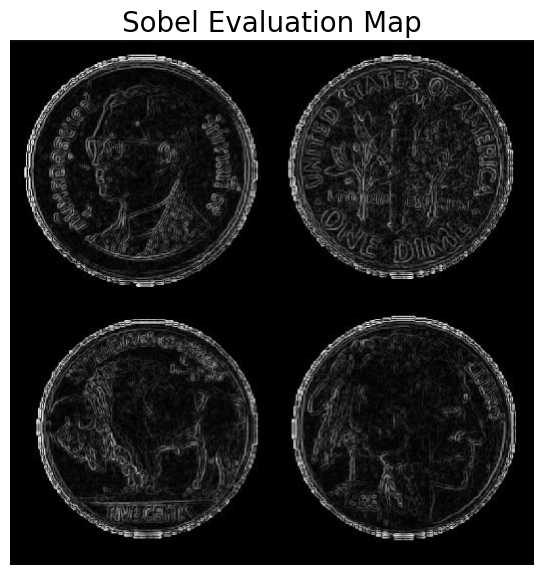

In [ ]:
from skimage.filters import sobel

elevation_map = sobel(coins)

pylab.figure(figsize=(20, 15))
pylab.gray()
pylab.subplot(221), plot_image(elevation_map, 'Sobel Evaluation Map')
pylab.show()

---
### Segmentation with Watershed
---

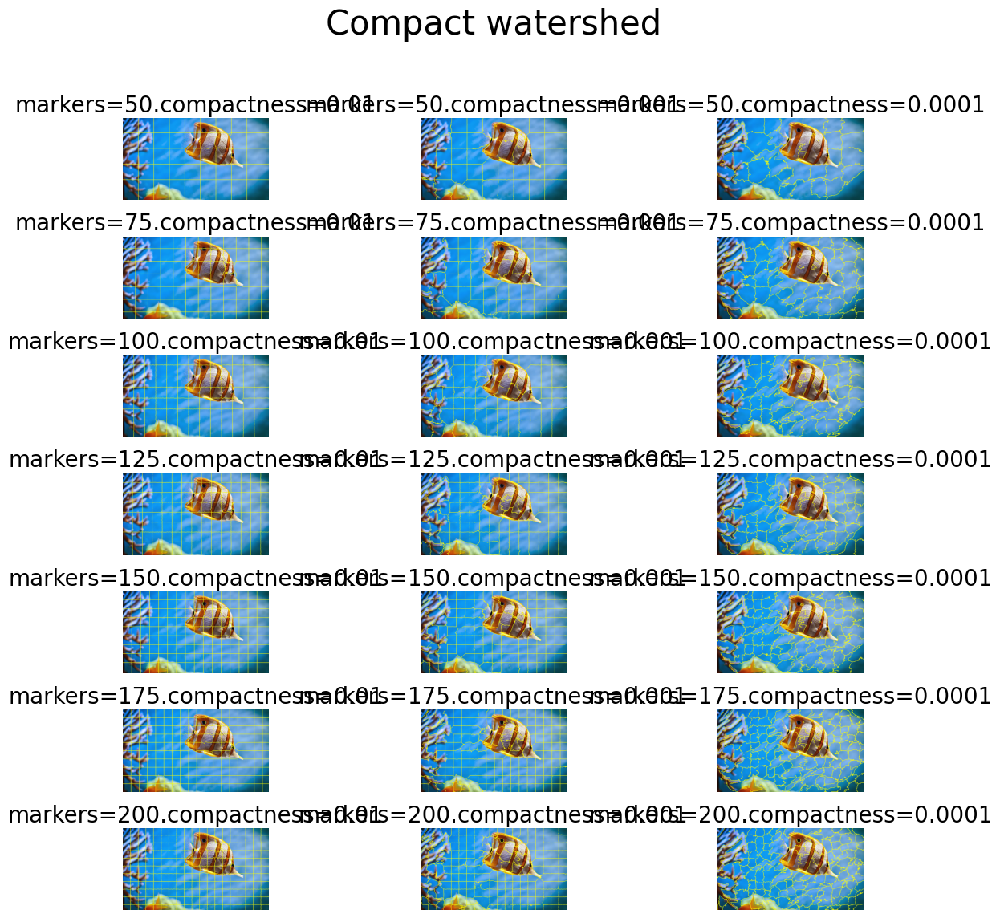

In [ ]:
img = imread('images/fish.jpg')[::2, ::2, :3] #img_as_float(astronaut()[::2, ::2])

gradient = sobel(rgb2gray(img))
plt.figure(figsize=(12,12))
i = 1
for markers in [50, 75, 100, 125, 150, 175, 200]:
    for compactness in [0.01, 0.001, 0.0001]:
        plt.subplot(7,3,i)
        '''A higher compactness value makes the segmentation prefer more compact
        and rounder regions, potentially avoiding irregularly shaped segments'''
        segments_watershed = watershed(gradient, markers=markers, compactness=compactness)
        plot_image(mark_boundaries(img, segments_watershed), 'markers=' + str(markers) + '.compactness=' + str(compactness))
        i += 1
plt.suptitle('Compact watershed', size=30)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

---
### Felzenszwalb's efficient graph-based image segmentation
---

In [ ]:
from skimage.data import astronaut
from skimage.io import imread
from skimage.color import rgb2gray
from skimage.segmentation import felzenszwalb, slic, watershed
from skimage.segmentation import mark_boundaries, find_boundaries
from skimage.util import img_as_float

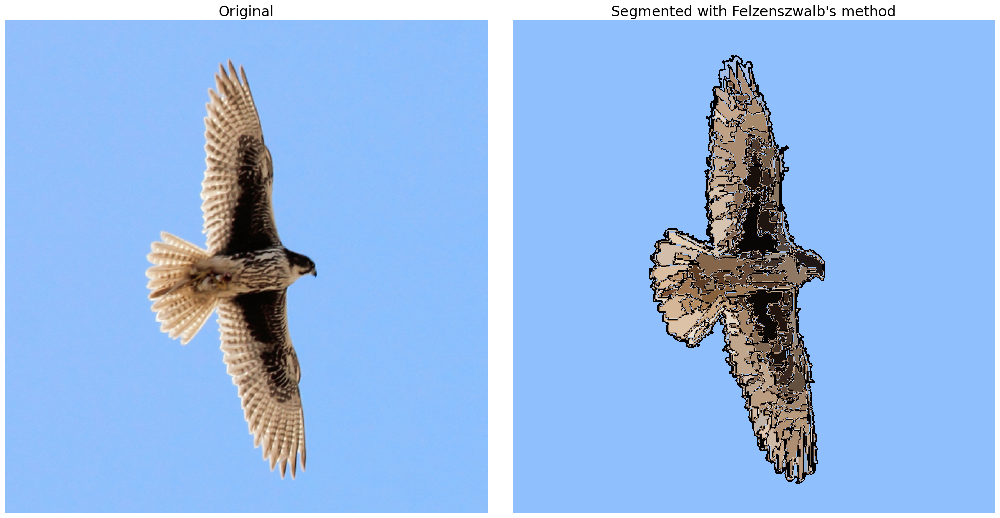

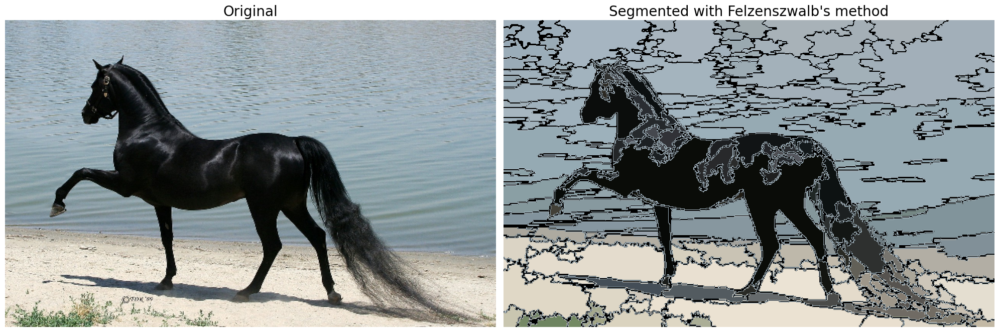

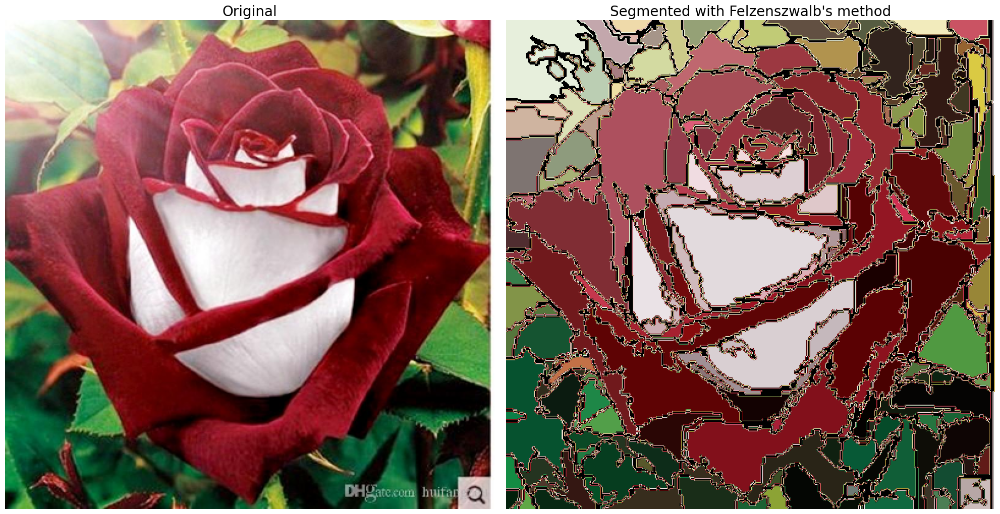

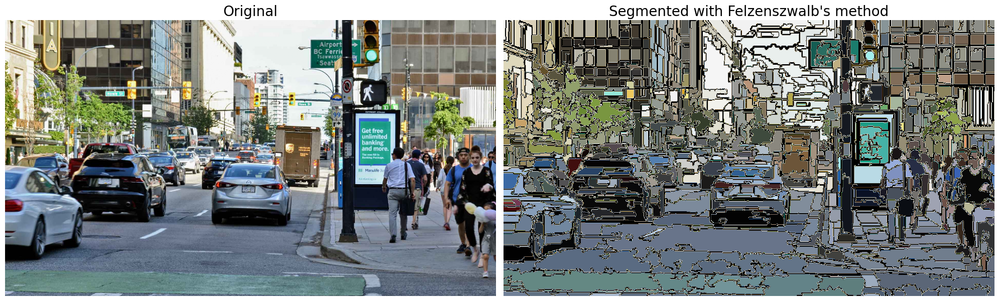

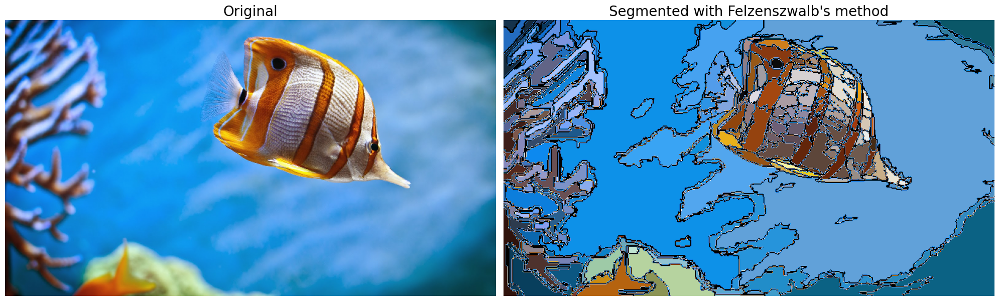

In [ ]:
from skimage.io import imread
from skimage import img_as_float
from skimage.segmentation import felzenszwalb, find_boundaries
from matplotlib.colors import LinearSegmentedColormap
import numpy as np
import matplotlib.pyplot as plt

for imfile in ['images/eagle2.jpg', 'images/horse3.jpg', 'images/flower.jpg', 'images/street.jpg', 'images/fish.jpg']:
    img = img_as_float(imread(imfile)[::2, ::2, :3])

    plt.figure(figsize=(20, 10))

    ''' scale: A higher scale means fewer, larger segments, and a smaller scale results in more, smaller segments.
        sigma: standard deviation of Gaussian kernel used in preprocessing
        min_size: the minimum size for any segment produced by the algorithm.
        Segments that are smaller than this size will be merged with neighboring segments.'''

    segments_fz = felzenszwalb(img, scale=100, sigma=0.5, min_size=100) # Adjust parameters as needed

    borders = find_boundaries(segments_fz)
    unique_colors = np.unique(segments_fz.ravel())
    segments_fz[borders] = -1 # Mark the borders in the segments image
    colors = [np.zeros(3)]  # Default color for borders
    for color in unique_colors:
        mask = segments_fz == color
        if np.any(mask):
            color_mean = np.mean(img[mask], axis=0)
            if np.any(np.isnan(color_mean)):
                colors.append(np.zeros(3))  # Assign default color if NaN
            else:
                colors.append(color_mean)
        else:
            colors.append(np.zeros(3))  # Assign default color if segment is empty

    cm = LinearSegmentedColormap.from_list('palette', colors, N=len(colors))

    plt.subplot(121), plt.imshow(img), plt.title('Original', size=20), plt.axis('off')
    plt.subplot(122), plt.imshow(segments_fz, cmap=cm), plt.title('Segmented with Felzenszwalb\'s method', size=20)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

---
### Segmentation with SLIC
---

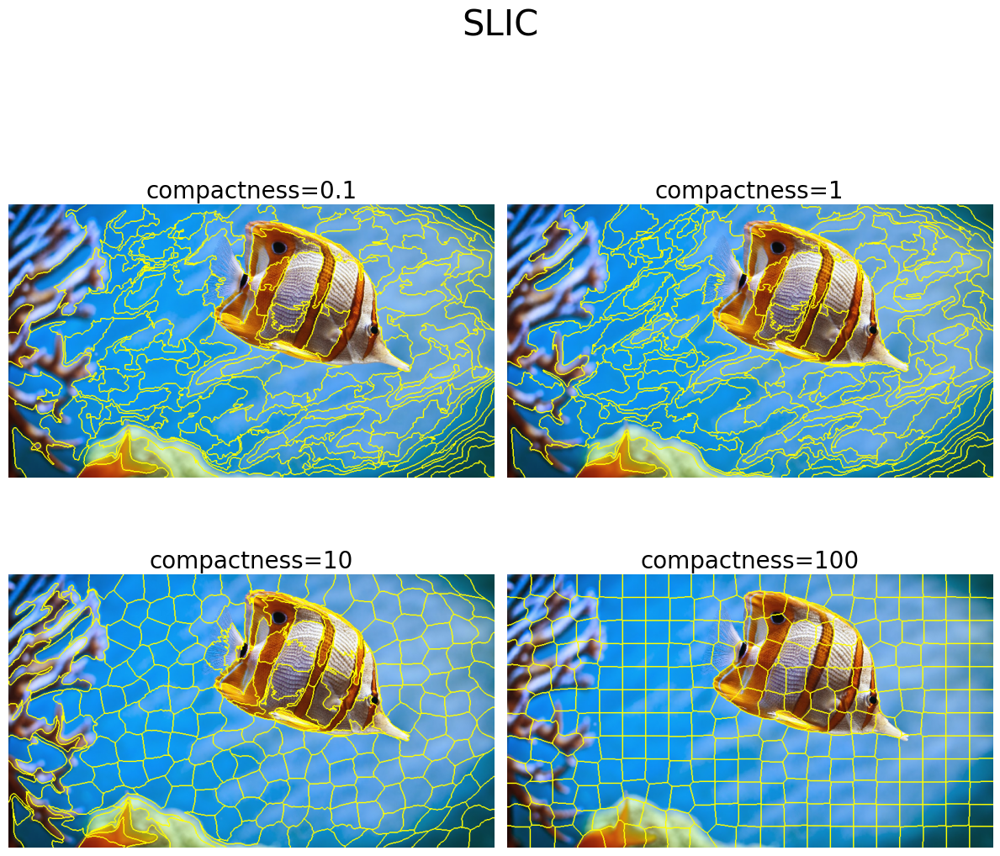

In [ ]:
plt.figure(figsize=(12,12))
i = 1
for compactness in [0.1, 1, 10, 100]:
    plt.subplot(2,2,i)
    segments_slic = slic(img, n_segments=250, compactness=compactness, sigma=1)
    plot_image(mark_boundaries(img, segments_slic), 'compactness=' + str(compactness))
    i += 1
plt.suptitle('SLIC', size=30)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

# Tasks:

1. Segment an image using global thresholding and then Otsu’s method. Compare the results and discuss under what conditions each method performs better.

2. For each segmentation method (Felzenszwalb and SLIC), experiment with varying parameters like scale, sigma, min_size for Felzenszwalb; and n_segments, compactness for SLIC. Observe how these changes affect the segmentation results.

Task 1 :

In [ ]:
import numpy as np
from skimage.transform import (hough_line, hough_line_peaks, hough_circle, hough_circle_peaks)
from skimage.draw import circle_perimeter
from skimage.feature import canny
from skimage.data import astronaut
from skimage.io import imread, imsave
from skimage.color import rgb2gray, gray2rgb, label2rgb
from skimage import img_as_float
from skimage.morphology import skeletonize
from skimage import data, img_as_float
import matplotlib.pyplot as pylab
import matplotlib.pyplot as plt
from matplotlib import cm
from skimage.filters import sobel, threshold_otsu
from skimage.feature import canny
from skimage.segmentation import felzenszwalb, slic, watershed
from skimage.segmentation import mark_boundaries, find_boundaries


def plot_image(image, title='', fontsize=5):
    pylab.title(title, size=20), pylab.imshow(image)
    pylab.axis('off') # comment this line if you want axis ticks

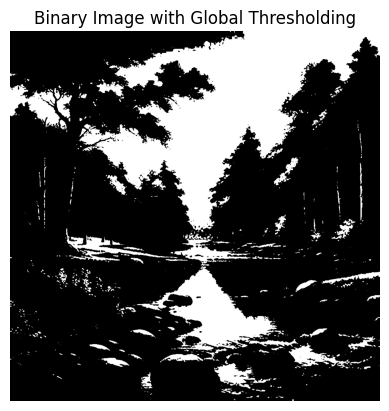

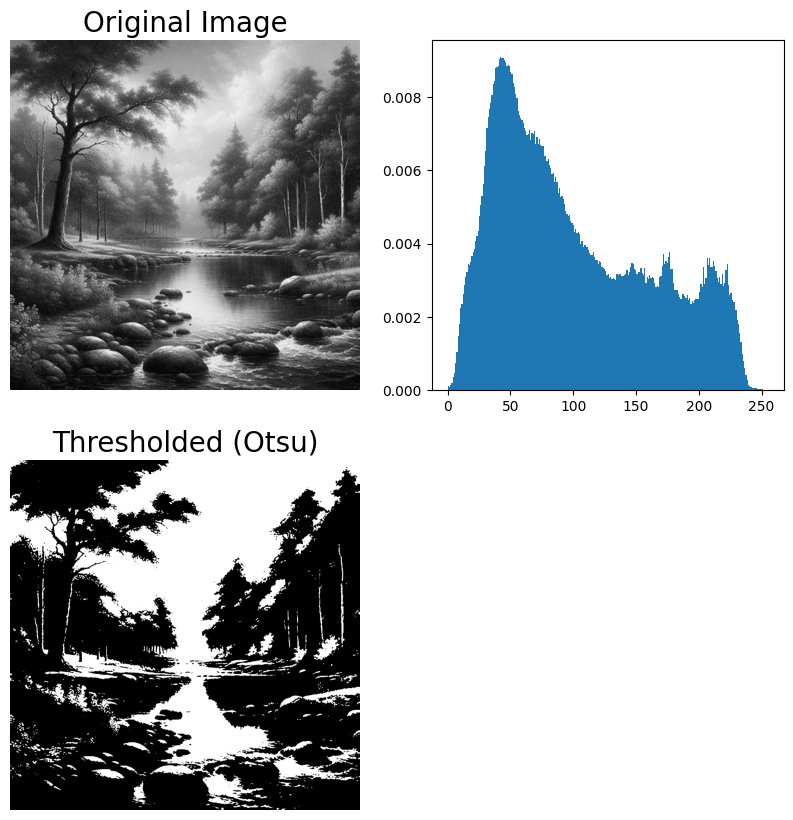

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
# Read the image in grayscale (0 specifies grayscale mode)
image = cv2.imread('/landscape2.jpeg', 0)

# Check if the image has been loaded correctly
if image is None:
    print("Error loading image")
else:
    # Apply global thresholding (As we used to do in the theory)
    _, binary_image = cv2.threshold(image, 150, 255, cv2.THRESH_BINARY)
    plt.imshow(binary_image, cmap='gray')
    plt.title('Binary Image with Global Thresholding')
    plt.axis('off')
    plt.show()

    #------------------------------------------------------


thresh = threshold_otsu(image)
binary = image > thresh

pylab.figure(figsize=(10, 10))
pylab.gray()
pylab.subplot(221), plot_image(image, 'Original Image')
plt.subplot(222), plt.hist(image.ravel(), bins=256, density=True)
pylab.subplot(223), plot_image(binary, 'Thresholded (Otsu)')
pylab.show()


In case o this image the Otsu thresholding where better and showing more details for the lighting difference on the image .

Global Thresholding is preferable for images with uniform lighting, high contrast, simple scenes, and low noise.
Otsu's Thresholding excels in images with variable lighting, moderate noise, complex scenes, and bi-modal histograms.

Task 2 :Felzenszwalb

In [ ]:
from skimage.data import astronaut
from skimage.io import imread
from skimage.color import rgb2gray
from skimage.segmentation import felzenszwalb, slic, watershed
from skimage.segmentation import mark_boundaries, find_boundaries
from skimage.util import img_as_float

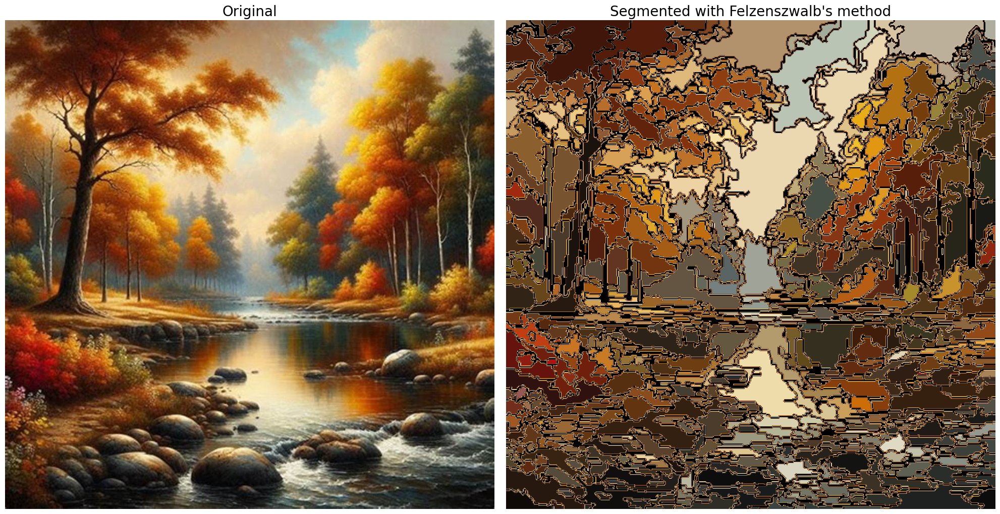

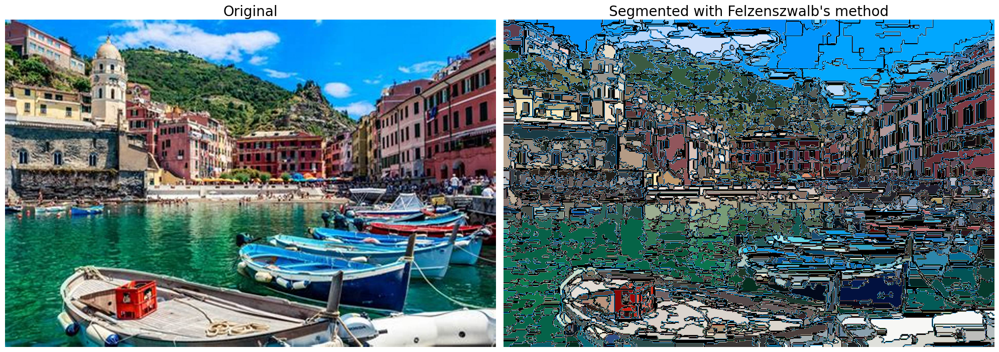

In [ ]:
from skimage.io import imread
from skimage import img_as_float
from skimage.segmentation import felzenszwalb, find_boundaries
from matplotlib.colors import LinearSegmentedColormap
import numpy as np
import matplotlib.pyplot as plt

for imfile in ['/landscape2.jpeg', '/Italy.jpeg']:
    img = img_as_float(imread(imfile)[::2, ::2, :3])

    plt.figure(figsize=(20, 10))

    ''' scale: A higher scale means fewer, larger segments, and a smaller scale results in more, smaller segments.
        sigma: standard deviation of Gaussian kernel used in preprocessing
        min_size: the minimum size for any segment produced by the algorithm.
        Segments that are smaller than this size will be merged with neighboring segments.'''

    segments_fz = felzenszwalb(img, scale=50, sigma=1, min_size=50) # Adjust parameters as needed

    borders = find_boundaries(segments_fz)
    unique_colors = np.unique(segments_fz.ravel())
    segments_fz[borders] = -1 # Mark the borders in the segments image
    colors = [np.zeros(3)]  # Default color for borders
    for color in unique_colors:
        mask = segments_fz == color
        if np.any(mask):
            color_mean = np.mean(img[mask], axis=0)
            if np.any(np.isnan(color_mean)):
                colors.append(np.zeros(3))  # Assign default color if NaN
            else:
                colors.append(color_mean)
        else:
            colors.append(np.zeros(3))  # Assign default color if segment is empty

    cm = LinearSegmentedColormap.from_list('palette', colors, N=len(colors))

    plt.subplot(121), plt.imshow(img), plt.title('Original', size=20), plt.axis('off')
    plt.subplot(122), plt.imshow(segments_fz, cmap=cm), plt.title('Segmented with Felzenszwalb\'s method', size=20)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

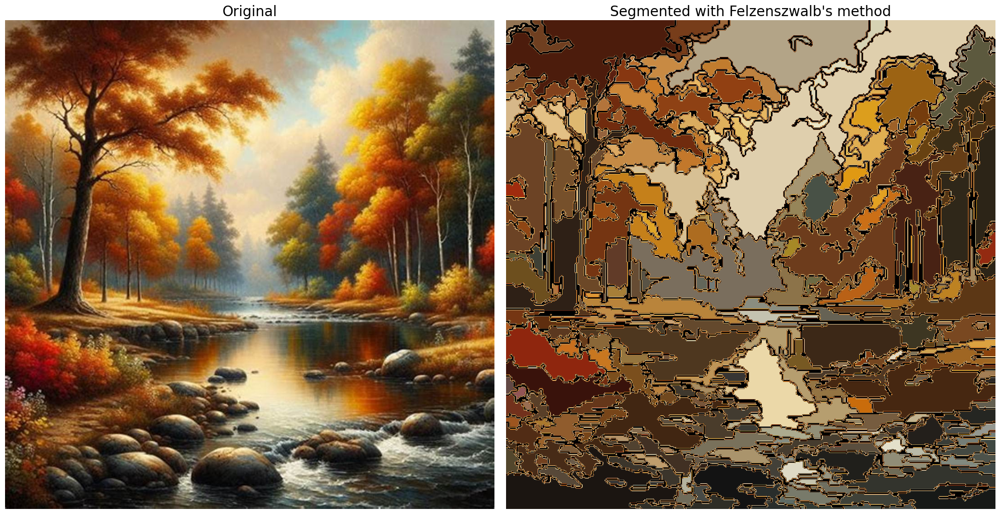

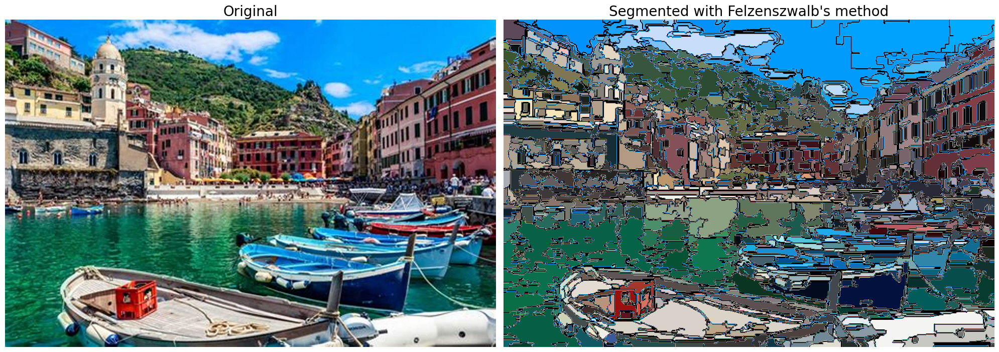

In [ ]:
from skimage.io import imread
from skimage import img_as_float
from skimage.segmentation import felzenszwalb, find_boundaries
from matplotlib.colors import LinearSegmentedColormap
import numpy as np
import matplotlib.pyplot as plt

for imfile in ['/landscape2.jpeg', '/Italy.jpeg']:
    img = img_as_float(imread(imfile)[::2, ::2, :3])

    plt.figure(figsize=(20, 10))

    ''' scale: A higher scale means fewer, larger segments, and a smaller scale results in more, smaller segments.
        sigma: standard deviation of Gaussian kernel used in preprocessing
        min_size: the minimum size for any segment produced by the algorithm.
        Segments that are smaller than this size will be merged with neighboring segments.'''

    segments_fz = felzenszwalb(img, scale=100, sigma=1, min_size=100) # Adjust parameters as needed

    borders = find_boundaries(segments_fz)
    unique_colors = np.unique(segments_fz.ravel())
    segments_fz[borders] = -1 # Mark the borders in the segments image
    colors = [np.zeros(3)]  # Default color for borders
    for color in unique_colors:
        mask = segments_fz == color
        if np.any(mask):
            color_mean = np.mean(img[mask], axis=0)
            if np.any(np.isnan(color_mean)):
                colors.append(np.zeros(3))  # Assign default color if NaN
            else:
                colors.append(color_mean)
        else:
            colors.append(np.zeros(3))  # Assign default color if segment is empty

    cm = LinearSegmentedColormap.from_list('palette', colors, N=len(colors))

    plt.subplot(121), plt.imshow(img), plt.title('Original', size=20), plt.axis('off')
    plt.subplot(122), plt.imshow(segments_fz, cmap=cm), plt.title('Segmented with Felzenszwalb\'s method', size=20)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

By mantaining the sigma value and changing the scale I have discoverd that smaler scale vlue means more segments and smaller ones

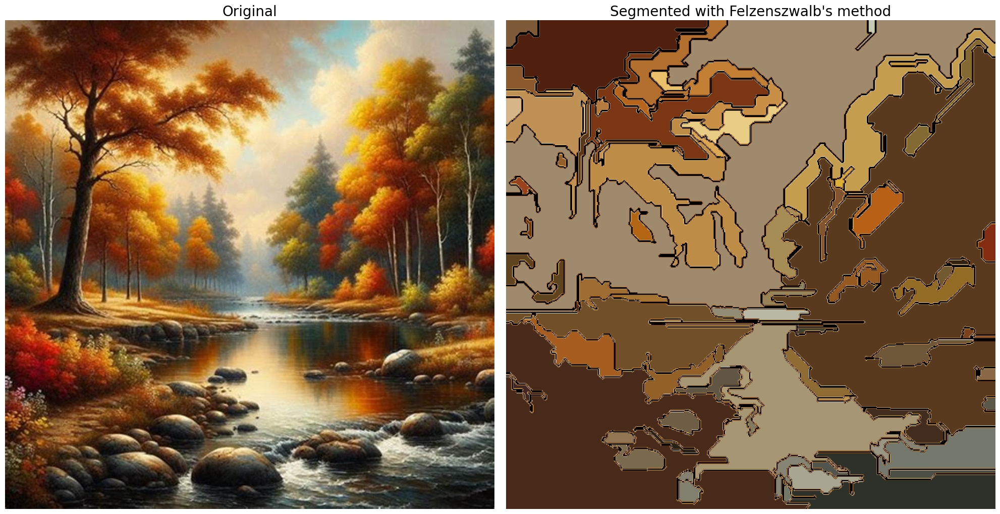

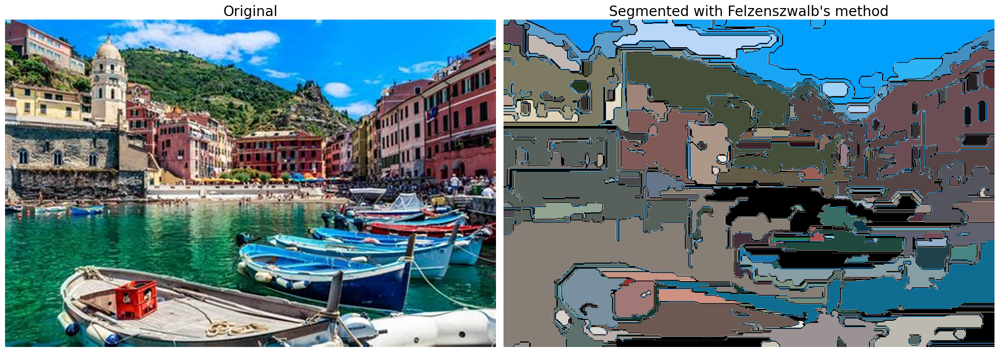

In [ ]:
from skimage.io import imread
from skimage import img_as_float
from skimage.segmentation import felzenszwalb, find_boundaries
from matplotlib.colors import LinearSegmentedColormap
import numpy as np
import matplotlib.pyplot as plt

for imfile in ['/landscape2.jpeg', '/Italy.jpeg']:
    img = img_as_float(imread(imfile)[::2, ::2, :3])

    plt.figure(figsize=(20, 10))

    ''' scale: A higher scale means fewer, larger segments, and a smaller scale results in more, smaller segments.
        sigma: standard deviation of Gaussian kernel used in preprocessing
        min_size: the minimum size for any segment produced by the algorithm.
        Segments that are smaller than this size will be merged with neighboring segments.'''

    segments_fz = felzenszwalb(img, scale=100, sigma=5, min_size=100) # Adjust parameters as needed

    borders = find_boundaries(segments_fz)
    unique_colors = np.unique(segments_fz.ravel())
    segments_fz[borders] = -1 # Mark the borders in the segments image
    colors = [np.zeros(3)]  # Default color for borders
    for color in unique_colors:
        mask = segments_fz == color
        if np.any(mask):
            color_mean = np.mean(img[mask], axis=0)
            if np.any(np.isnan(color_mean)):
                colors.append(np.zeros(3))  # Assign default color if NaN
            else:
                colors.append(color_mean)
        else:
            colors.append(np.zeros(3))  # Assign default color if segment is empty

    cm = LinearSegmentedColormap.from_list('palette', colors, N=len(colors))

    plt.subplot(121), plt.imshow(img), plt.title('Original', size=20), plt.axis('off')
    plt.subplot(122), plt.imshow(segments_fz, cmap=cm), plt.title('Segmented with Felzenszwalb\'s method', size=20)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

with keeping the scale and make the sigma larger I have discovred that : the standard dviation will affect the segment and show less details and not alot of colors
A higher sigma value will increase the smoothing effect, resulting in fewer segments with less detail. A lower sigma value will retain more detail and produce more segments.

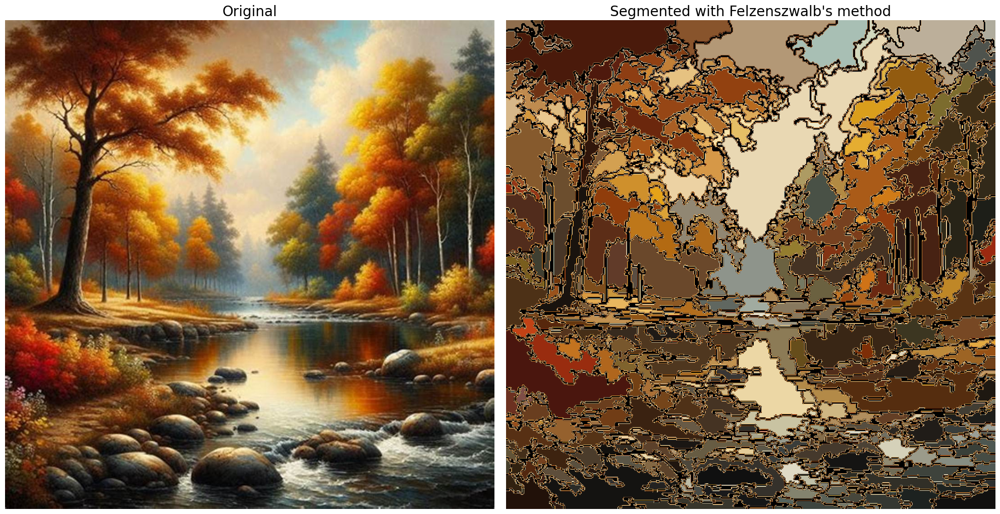

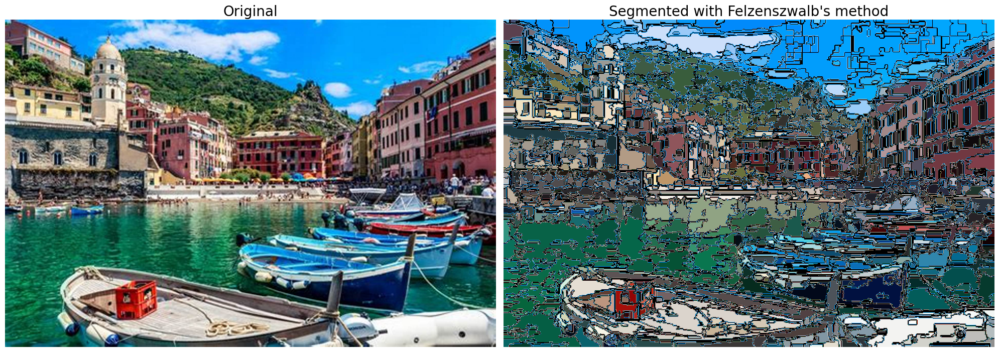

In [ ]:
from skimage.io import imread
from skimage import img_as_float
from skimage.segmentation import felzenszwalb, find_boundaries
from matplotlib.colors import LinearSegmentedColormap
import numpy as np
import matplotlib.pyplot as plt

for imfile in ['/landscape2.jpeg', '/Italy.jpeg']:
    img = img_as_float(imread(imfile)[::2, ::2, :3])

    plt.figure(figsize=(20, 10))

    ''' scale: A higher scale means fewer, larger segments, and a smaller scale results in more, smaller segments.
        sigma: standard deviation of Gaussian kernel used in preprocessing
        min_size: the minimum size for any segment produced by the algorithm.
        Segments that are smaller than this size will be merged with neighboring segments.'''

    segments_fz = felzenszwalb(img, scale=100, sigma=0.5, min_size=50) # Adjust parameters as needed

    borders = find_boundaries(segments_fz)
    unique_colors = np.unique(segments_fz.ravel())
    segments_fz[borders] = -1 # Mark the borders in the segments image
    colors = [np.zeros(3)]  # Default color for borders
    for color in unique_colors:
        mask = segments_fz == color
        if np.any(mask):
            color_mean = np.mean(img[mask], axis=0)
            if np.any(np.isnan(color_mean)):
                colors.append(np.zeros(3))  # Assign default color if NaN
            else:
                colors.append(color_mean)
        else:
            colors.append(np.zeros(3))  # Assign default color if segment is empty

    cm = LinearSegmentedColormap.from_list('palette', colors, N=len(colors))

    plt.subplot(121), plt.imshow(img), plt.title('Original', size=20), plt.axis('off')
    plt.subplot(122), plt.imshow(segments_fz, cmap=cm), plt.title('Segmented with Felzenszwalb\'s method', size=20)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

By decrasing the min size we can see smaller segments ,
Higher min_size: Leads to fewer, larger segments because small segments are merged with neighboring regions. This can be useful for reducing noise and creating more meaningful, sizable segments.
Lower min_size: Allows for more, smaller segments, which can capture finer details in the image. However, it may also result in noisy or less significant segments, especially in areas with small variations in pixel intensity.

Task 2 , *SLIC* The affect of the compactness

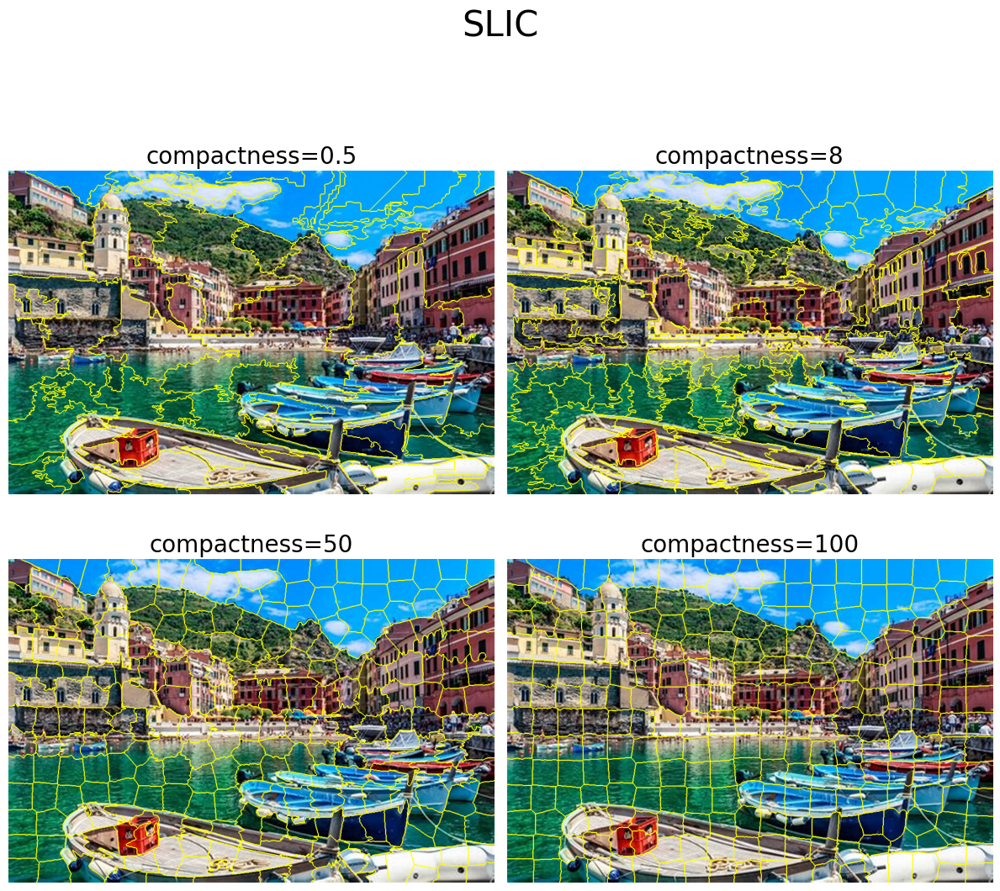

In [ ]:
plt.figure(figsize=(12,12))
i = 1
for compactness in [0.5, 8, 50, 100]:
    plt.subplot(2,2,i)
    segments_slic = slic(img, n_segments=250, compactness=compactness, sigma=1)
    plot_image(mark_boundaries(img, segments_slic), 'compactness=' + str(compactness))
    i += 1
plt.suptitle('SLIC', size=30)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

As we see above the affect of the compactness is that larger ones will be  more squared or rounded and smaller ones take irregular shapes

Task2 SLIC the affect of the number of segments

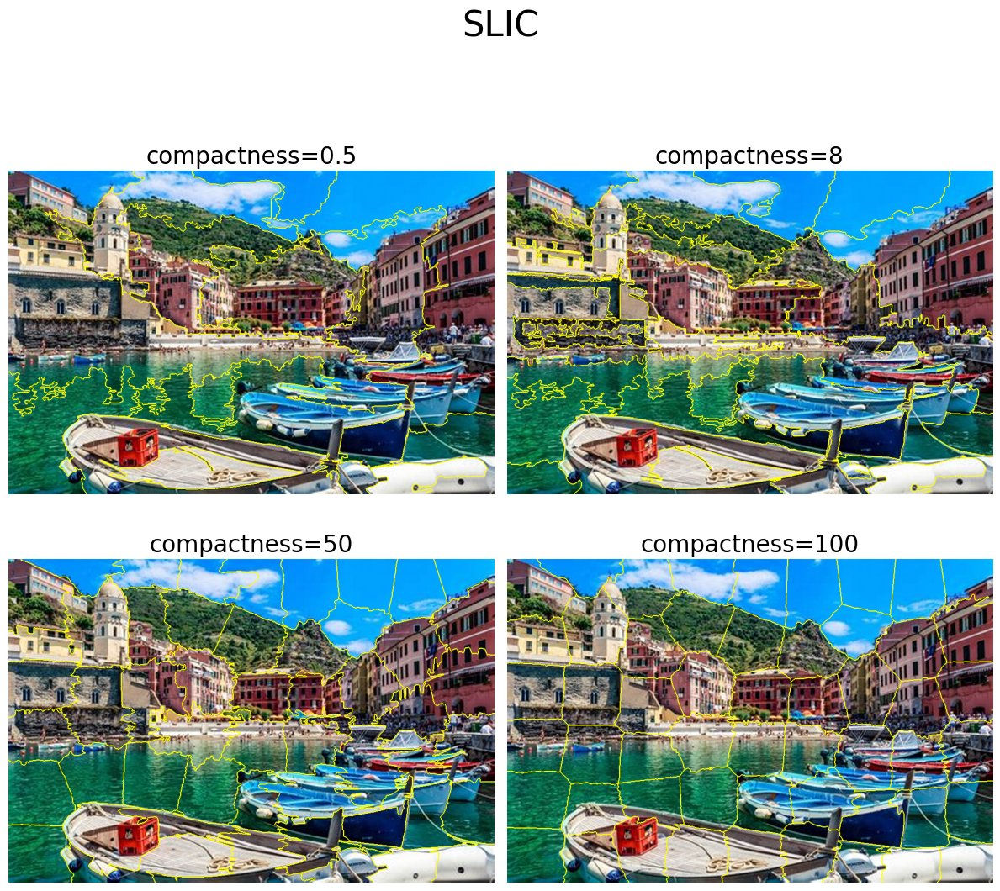

In [ ]:
plt.figure(figsize=(12,12))
i = 1
for compactness in [0.5, 8, 50, 100]:
    plt.subplot(2,2,i)
    segments_slic = slic(img, n_segments=50, compactness=compactness, sigma=1)
    plot_image(mark_boundaries(img, segments_slic), 'compactness=' + str(compactness))
    i += 1
plt.suptitle('SLIC', size=30)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

Higher n_segments: Produces more, smaller superpixels. This can be useful for capturing fine details in the image.
Lower n_segments: Produces fewer, larger superpixels. This can simplify the image and reduce the number of regions, which can be useful for tasks requiring less granularity.

SLIC and sigma

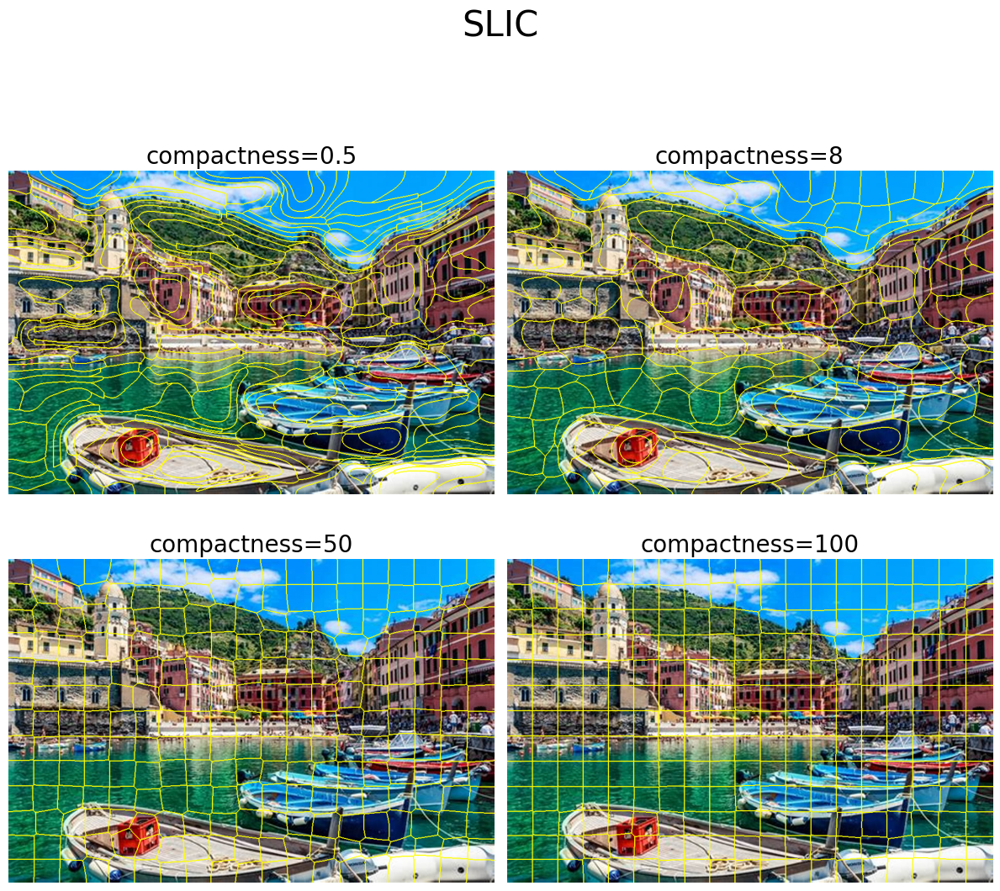

In [ ]:
plt.figure(figsize=(12,12))
i = 1
for compactness in [0.5, 8, 50, 100]:
    plt.subplot(2,2,i)
    segments_slic = slic(img, n_segments=250, compactness=compactness, sigma=20)
    plot_image(mark_boundaries(img, segments_slic), 'compactness=' + str(compactness))
    i += 1
plt.suptitle('SLIC', size=30)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

Higher sigma: Can lead to the loss of fine details because the smoothing process blurs the image, making it harder for the algorithm to detect small features.
Lower sigma: Better preserves fine details, which is useful when the goal is to capture as much of the original image's structure as possible.

so mainly higher sigma value will not show fine details